In [1]:
!pip install youtube-dl
!pip install librosa
!pip install matplotlib
!pip install numpy
!pip install ipympl
!pip install yt_dlp

import IPython.display as ipd
from google.colab import output
output.enable_custom_widget_manager()
%matplotlib widget

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## ***Downloading a song from Youtube, displaying and saving it***

### `song_url` is the url of the youtube video, the .wav file will be saved as `song.wav`

In [2]:
song_url = 'https://www.youtube.com/watch?v=dvgZkm1xWPE'
song_id = song_url.split('=')[1]

In [3]:
import yt_dlp as youtube_dl

ydl_opts = {
    'format': 'bestaudio/best',
    'postprocessors': [{
        'key': 'FFmpegExtractAudio',
        'preferredcodec': 'wav',
        'preferredquality': '320',
    }],
    'outtmpl': 'song'
}

with youtube_dl.YoutubeDL(ydl_opts) as ydl:
  ydl.download([song_url])


[youtube] Extracting URL: https://www.youtube.com/watch?v=dvgZkm1xWPE
[youtube] dvgZkm1xWPE: Downloading webpage
[youtube] dvgZkm1xWPE: Downloading android player API JSON
[info] dvgZkm1xWPE: Downloading 1 format(s): 251
[dashsegments] Total fragments: 1
[download] Destination: song
[download] 100% of    3.78MiB in 00:00:00 at 22.63MiB/s              
[ExtractAudio] Destination: song.wav
Deleting original file song (pass -k to keep)


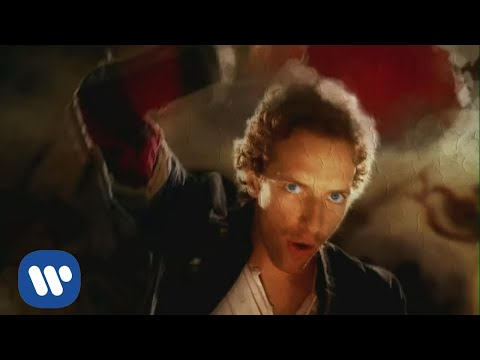

In [4]:
from IPython.display import YouTubeVideo

#  YouTubeVideo object with the video ID
video = YouTubeVideo(song_id)
display(video)

In [5]:
import IPython.display as ipd
import librosa

x, sr = librosa.load('song.wav')
ipd.Audio(x, rate=sr)

## ***Visualization***

**Spectrogram**

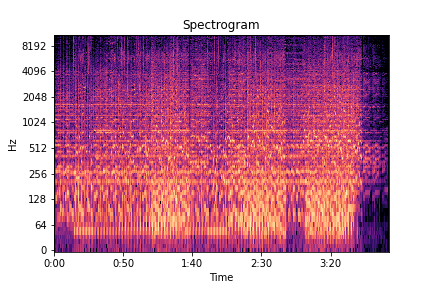

In [6]:
import matplotlib.pyplot as plt
import librosa
import librosa.display
import numpy as np

y, sr = librosa.load("song.wav")
D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
plt.figure()
plt.title("Spectrogram")
librosa.display.specshow(D, y_axis='log', x_axis='time',sr=sr)

**Waveform**

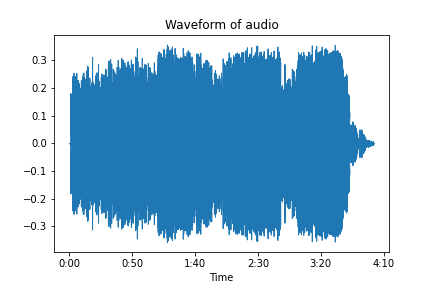

In [7]:
plt.figure()
librosa.display.waveshow(y, sr=sr)
plt.title("Waveform of audio")
plt.show()

**Chromagram**

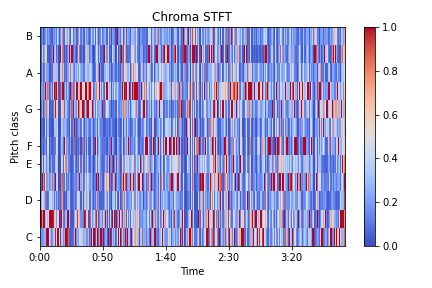

In [8]:
chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)
plt.figure()
librosa.display.specshow(chroma_stft, sr=sr, x_axis='time', y_axis='chroma', cmap='coolwarm')
plt.colorbar()
plt.title('Chroma STFT')
plt.tight_layout()
plt.show()

## ***Segmentation and Feature Extraction***

In [9]:
from __future__ import print_function

import numpy as np
import scipy
import matplotlib.pyplot as plt

import sklearn.cluster

import librosa
import librosa.display

**Loading the song**

In [10]:
y, sr = librosa.load("song.wav")

**Log-power CQT (constant-Q transform)**  
The CQT is a frequency-domain transformation that is similar to the more well-known Fourier transform, but is based on a logarithmic frequency scale.

<ipython-input-11-3bd303cabd30>:3: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  C = librosa.amplitude_to_db(librosa.cqt(y=y, sr=sr, bins_per_octave=BINS_PER_OCTAVE, n_bins=N_OCTAVES * BINS_PER_OCTAVE), ref=np.max)


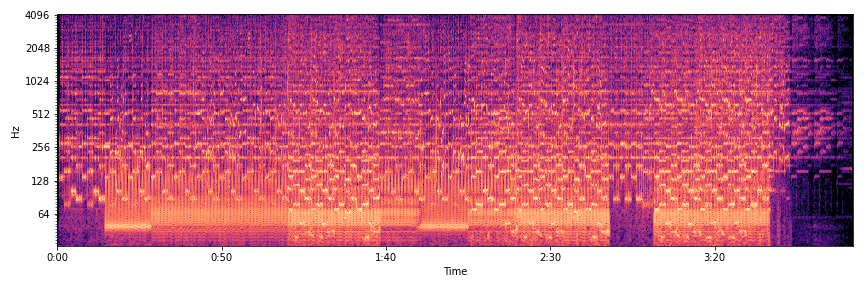

In [11]:
BINS_PER_OCTAVE = 12 * 3
N_OCTAVES = 7
C = librosa.amplitude_to_db(librosa.cqt(y=y, sr=sr, bins_per_octave=BINS_PER_OCTAVE, n_bins=N_OCTAVES * BINS_PER_OCTAVE), ref=np.max)
plt.figure(figsize=(12, 4))
librosa.display.specshow(C, y_axis='cqt_hz', sr=sr, bins_per_octave=BINS_PER_OCTAVE, x_axis='time')
plt.tight_layout()

**Beat-synchronous the CQT to reduce dimensionality**

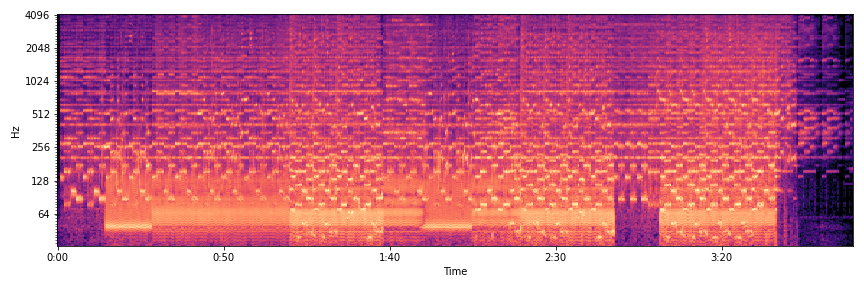

In [12]:
tempo, beats = librosa.beat.beat_track(y=y, sr=sr, trim=False)
Csync = librosa.util.sync(C, beats, aggregate=np.median)
beat_times = librosa.frames_to_time(librosa.util.fix_frames(beats, x_min=0, x_max=C.shape[1]), sr=sr)[:len(Csync[0])]

plt.figure(figsize=(12, 4))
librosa.display.specshow(Csync, bins_per_octave=12*3, y_axis='cqt_hz', x_axis='time', x_coords=beat_times)
plt.tight_layout()

**Building a weighted recurrence matrix**

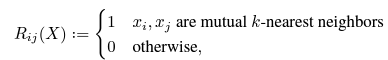  
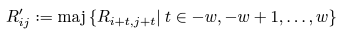

In [13]:
R = librosa.segment.recurrence_matrix(Csync, width=3, mode='affinity', sym=True)
# Enhance diagonals with a median filter (Equation 2)
df = librosa.segment.timelag_filter(scipy.ndimage.median_filter)
Rf = df(R, size=(1, 7))

**Building the sequence matrix**

In [14]:
mfcc = librosa.feature.mfcc(y=y, sr=sr)
Msync = librosa.util.sync(mfcc, beats)
path_distance = np.sum(np.diff(Msync, axis=1)**2, axis=0)
sigma = np.median(path_distance)
path_sim = np.exp(-path_distance / sigma)
R_path = np.diag(path_sim, k=1) + np.diag(path_sim, k=-1)

**Computing the balanced combination**

In [15]:
deg_path = np.sum(R_path, axis=1)
deg_rec = np.sum(Rf, axis=1)
mu = deg_path.dot(deg_path + deg_rec) / np.sum((deg_path + deg_rec)**2)
A = mu * Rf + (1 - mu) * R_path

**Plotting the graphs**

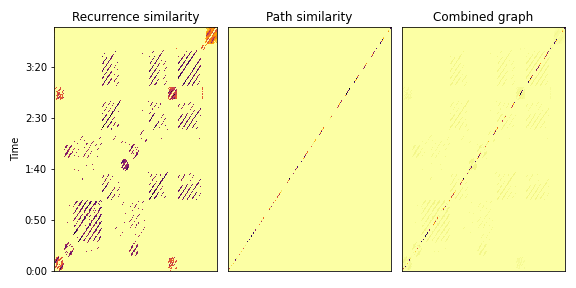

In [16]:
plt.figure(figsize=(8, 4))
plt.subplot(1, 3, 1)
librosa.display.specshow(Rf, cmap='inferno_r', y_axis='time', y_coords=beat_times)
plt.title('Recurrence similarity')
plt.subplot(1, 3, 2)
librosa.display.specshow(R_path, cmap='inferno_r')
plt.title('Path similarity')
plt.subplot(1, 3, 3)
librosa.display.specshow(A, cmap='inferno_r')
plt.title('Combined graph')
plt.tight_layout()

**Calculating the normalized Laplacian**

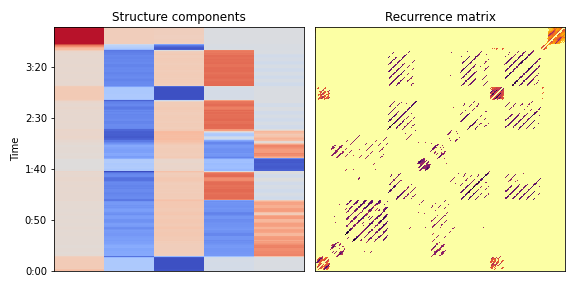

In [17]:
L = scipy.sparse.csgraph.laplacian(A, normed=True)

evals, evecs = scipy.linalg.eigh(L)


# We can clean this up further with a median filter.
# This can help smooth over small discontinuities
evecs = scipy.ndimage.median_filter(evecs, size=(9, 1))

# cumulative normalization is needed for symmetric normalize laplacian eigenvectors
Cnorm = np.cumsum(evecs**2, axis=1)**0.5

# If we want k clusters, use the first k normalized eigenvectors.
# TODO: change k to see how it affects the segmentation

k = 5

X = evecs[:, :k] / Cnorm[:, k-1:k]


plt.figure(figsize=(8, 4))
plt.subplot(1, 2, 2)
librosa.display.specshow(Rf, cmap='inferno_r')
plt.title('Recurrence matrix')

plt.subplot(1, 2, 1)
librosa.display.specshow(X, y_axis='time', y_coords=beat_times)
plt.title('Structure components')
plt.tight_layout()

**Clustering beats into segments**

/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


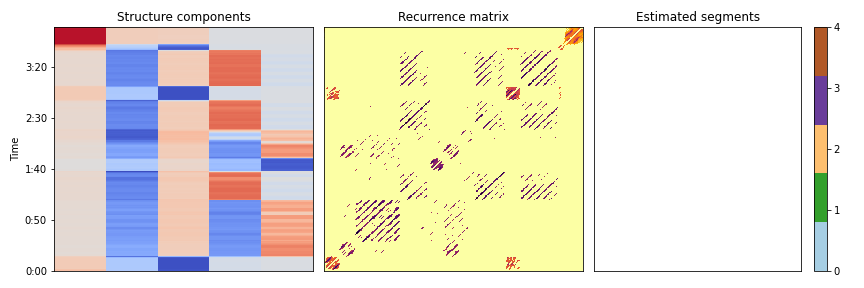

In [18]:
KM = sklearn.cluster.KMeans(n_clusters=k)

seg_ids = KM.fit_predict(X)


# and plot the results
plt.figure(figsize=(12, 4))
colors = plt.get_cmap('Paired', k)

plt.subplot(1, 3, 2)
librosa.display.specshow(Rf, cmap='inferno_r')
plt.title('Recurrence matrix')
plt.subplot(1, 3, 1)
librosa.display.specshow(X, y_axis='time', y_coords=beat_times)

plt.title('Structure components')
plt.subplot(1, 3, 3)
librosa.display.specshow(np.atleast_2d(seg_ids).T, cmap=colors)

plt.title('Estimated segments')
plt.colorbar(ticks=range(k))
plt.tight_layout()

**Locating segment boundaries from the label sequence**

In [19]:
bound_beats = 1 + np.flatnonzero(seg_ids[:-1] != seg_ids[1:])

bound_beats = librosa.util.fix_frames(bound_beats, x_min=0)

bound_segs = list(seg_ids[bound_beats])

# Convert beat indices to frames
bound_frames = beats[bound_beats]

bound_frames = librosa.util.fix_frames(bound_frames, x_min=None, x_max=C.shape[1]-1)

 **Final segmentation over original CQT**

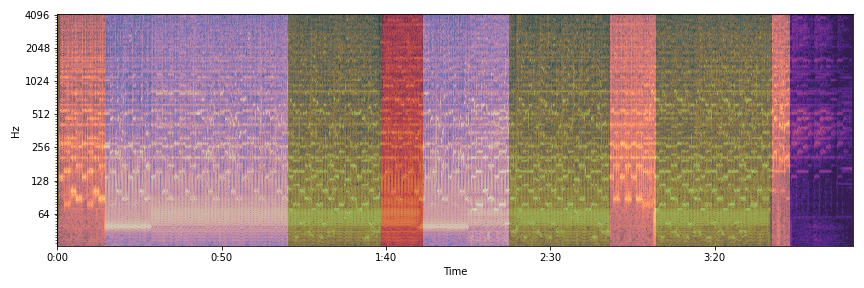

In [20]:
# sphinx_gallery_thumbnail_number = 5

import matplotlib.patches as patches
plt.figure(figsize=(12, 4))

bound_times = librosa.frames_to_time(bound_frames)
freqs = librosa.cqt_frequencies(n_bins=C.shape[0],
                                fmin=librosa.note_to_hz('C1'),
                                bins_per_octave=BINS_PER_OCTAVE)

librosa.display.specshow(C, y_axis='cqt_hz', sr=sr,
                         bins_per_octave=BINS_PER_OCTAVE,
                         x_axis='time')
ax = plt.gca()

for interval, label in zip(zip(bound_times, bound_times[1:]), bound_segs):
    ax.add_patch(patches.Rectangle((interval[0], freqs[0]),
                                   interval[1] - interval[0],
                                   freqs[-1],
                                   facecolor=colors(label),
                                   alpha=0.50))

plt.tight_layout()
plt.show()

## ***Details about the song***

In [21]:
import IPython.display as ipd

x, sr = librosa.load('song.wav')

**The intro of the song**  

The introduction part of the song is the first segment: 

In [22]:
print("The introduction starts at:", bound_times[0], "sec , and ends at: ", bound_times[1], " sec.")

audio = ipd.Audio(x[int(bound_times[0])*sr:int(bound_times[1])*sr], rate=sr)
print("Listen to the introduction:")
display(audio)

The introduction starts at: 0.37151927437641724 sec , and ends at:  14.698231292517006  sec.
Listen to the introduction:


**The first drum hit**

The segmentation is based on the change of a signal, and the idea is to detect the first transition (intro to first verse or perhaps the chorus or a build...)

In [23]:
print("Time when the first drum hits: ", bound_times[1], " sec.")
audio = ipd.Audio(x[int(bound_times[1]-2)*sr:int(bound_times[1]+2)*sr], rate=sr)
display(audio)

Time when the first drum hits:  14.698231292517006  sec.


**The first instance of the chorus**

Assuming a very strict structure of a song: intro -> verse -> chorus...  

In [24]:
print("Time when the first chorus instance starts: ", bound_times[2], " sec.")

audio = ipd.Audio(x[int(bound_times[2])*sr:int(bound_times[3])*sr], rate=sr)
print("Listen to the chorus:")
display(audio)

Time when the first chorus instance starts:  70.35646258503401  sec.
Listen to the chorus:


**Number of bars in the introduction part**

Assuming 4 beats per bar, the number of bars in the introduction part is the number of beats in the introduction divided by 4.  
Formula: number of bars = number of beats / number of beats per bar

In [25]:
# Load only the introduction part
start = bound_times[0] 
end = bound_times[1]    
y_intro, sr_intro = librosa.load("song.wav", sr=sr, offset=start, duration=end-start)
tempo_intro, beats_intro = librosa.beat.beat_track(y=y_intro, sr=sr_intro, trim=False)

beats_per_bar = 4

num_bars = len(beats_intro) / beats_per_bar

print("Number of bars in the introduction part: ", num_bars)


Number of bars in the introduction part:  8.0
